<a href="https://colab.research.google.com/github/motoroko/Image-Enchantment-ESPCN/blob/main/Image_Enchantment_model_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf

import os
import math
import numpy as np

from tensorflow import keras
from tensorflow.keras import layers,Sequential
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.optimizers import Adam

from IPython.display import display

In [ ]:
dataset_url = "http://www.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz"
data_dir = keras.utils.get_file(origin=dataset_url, fname="BSR", untar=True)
root_dir = os.path.join(data_dir, "BSDS500/data")

70778880/70763455 [==============================] - 1s 0us/step


In [ ]:
crop_size = 300
upscale_factor = 3
input_size = crop_size // upscale_factor
batch_size = 8

train_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="training",
    seed=1337,
    label_mode=None,
)

valid_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="validation",
    seed=1337,
    label_mode=None,
)

Found 500 files belonging to 1 classes.
Using 400 files for training.
Found 500 files belonging to 1 classes.
Using 100 files for validation.


In [ ]:
def scaling(input_image):
    input_image = input_image / 255.0
    return input_image


# Scale from (0, 255) to (0, 1)
train_ds = train_ds.map(scaling)
valid_ds = valid_ds.map(scaling)

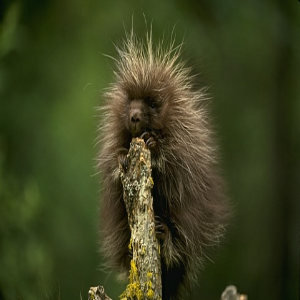

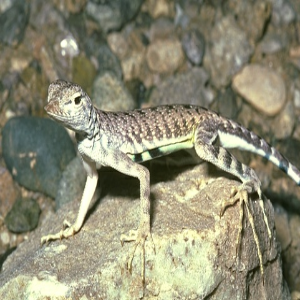

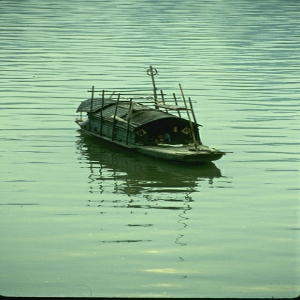

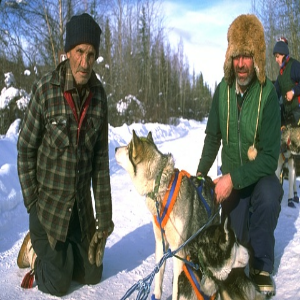

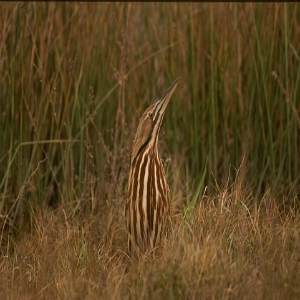

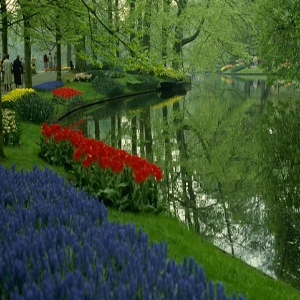

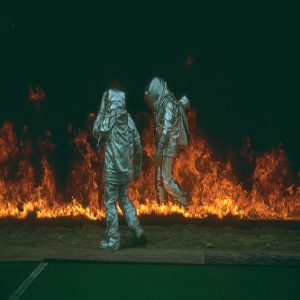

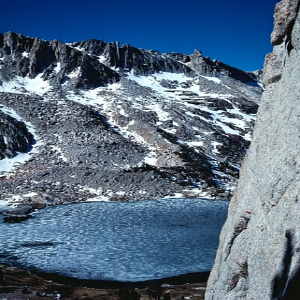

In [ ]:
for batch in train_ds.take(1):
    for img in batch:
        display(array_to_img(img))

In [ ]:
dataset = os.path.join(root_dir, "images")
test_path = os.path.join(dataset, "test")

test_img_paths = sorted(
    [
        os.path.join(test_path, fname)
        for fname in os.listdir(test_path)
        if fname.endswith(".jpg")
    ]
)

In [ ]:
# Use TF Ops to process.
def process_input(input, input_size, upscale_factor):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return tf.image.resize(y, [input_size, input_size], method="area")


def process_target(input):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return y


train_ds = train_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
train_ds = train_ds.prefetch(buffer_size=32)

valid_ds = valid_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
valid_ds = valid_ds.prefetch(buffer_size=32)

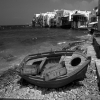

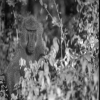

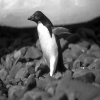

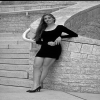

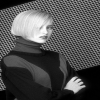

...

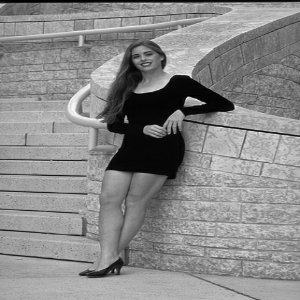

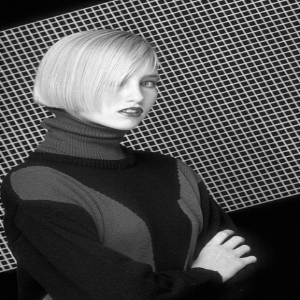

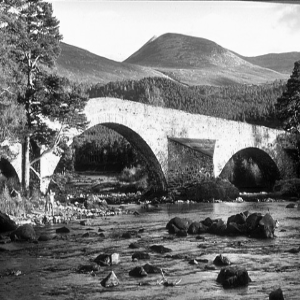

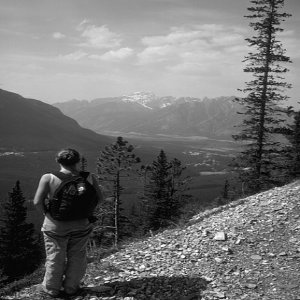

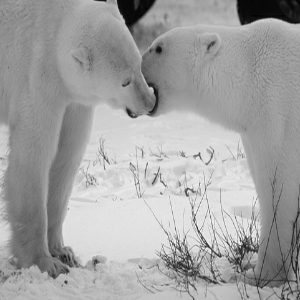

In [ ]:
for batch in train_ds.take(1):
    for img in batch[0]:
        display(array_to_img(img))
    for img in batch[1]:
        display(array_to_img(img))

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import PIL


def plot_results(img, prefix, title):
    """Plot the result with zoom-in area."""
    img_array = img_to_array(img)
    img_array = img_array.astype("float32") / 255.0

    # Create a new figure with a default 111 subplot.
    fig, ax = plt.subplots()
    im = ax.imshow(img_array[::-1], origin="lower")

    plt.title(title)
    # zoom-factor: 2.0, location: upper-left
    axins = zoomed_inset_axes(ax, 2, loc=2)
    axins.imshow(img_array[::-1], origin="lower")

    # Specify the limits.
    x1, x2, y1, y2 = 200, 300, 100, 200
    # Apply the x-limits.
    axins.set_xlim(x1, x2)
    # Apply the y-limits.
    axins.set_ylim(y1, y2)

    plt.yticks(visible=False)
    plt.xticks(visible=False)

    # Make the line.
    mark_inset(ax, axins, loc1=1, loc2=3, fc="none", ec="blue")
    plt.savefig(str(prefix) + "-" + title + ".png")
    plt.show()


def get_lowres_image(img, upscale_factor):
    """Return low-resolution image to use as model input."""
    return img.resize(
        (img.size[0] // upscale_factor, img.size[1] // upscale_factor),
        #PIL.Image.BICUBIC,
    )


def upscale_image(model, img):
    """Predict the result based on input image and restore the image as RGB."""
    ycbcr = img.convert("YCbCr")
    y, cb, cr = ycbcr.split()
    y = img_to_array(y)
    y = y.astype("float32") / 255.0

    input = np.expand_dims(y, axis=0)
    out = model.predict(input)

    out_img_y = out[0]
    out_img_y *= 255.0

    # Restore the image in RGB color space.
    out_img_y = out_img_y.clip(0, 255)
    out_img_y = out_img_y.reshape((np.shape(out_img_y)[0], np.shape(out_img_y)[1]))
    out_img_y = PIL.Image.fromarray(np.uint8(out_img_y), mode="L")
    out_img_cb = cb.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img_cr = cr.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img = PIL.Image.merge("YCbCr", (out_img_y, out_img_cb, out_img_cr)).convert(
        "RGB"
    )
    return out_img

#ESPCN

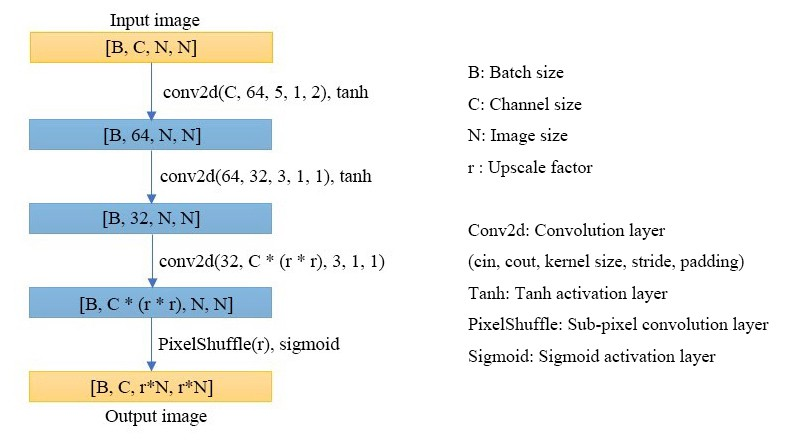

In [ ]:
def get_model(upscale_factor=5, channels=5):
    conv_args = {
        "activation": "relu",
        "kernel_initializer": "Orthogonal",
        "padding": "same",
    }
    inputs = keras.Input(shape=(None, None, channels))
    x = layers.Conv2D(64, 5, **conv_args)(inputs)
    x = layers.Conv2D(32, 3, **conv_args)(x)
    x = layers.Conv2D(channels * (upscale_factor ** 2), 3, **conv_args)(x)
    outputs = tf.nn.depth_to_space(x, upscale_factor)

    return keras.Model(inputs, outputs)

In [ ]:
class ESPCNCallback(keras.callbacks.Callback):
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.test_img = get_lowres_image(load_img(test_img_paths[0]), upscale_factor)

    # Store PSNR value in each epoch.
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):
        print("Mean PSNR for epoch: %.2f dB" % (np.mean(self.psnr)))
        prediction = upscale_image(self.model, self.test_img)
        plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        self.psnr.append(10 * math.log10(1 / logs["loss"]))

In [ ]:
class ESPCNCallback(keras.callbacks.Callback):
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.img = load_img(test_img_paths[0])
        self.test_img = get_lowres_image(self.img, upscale_factor)
        w = self.test_img.size[0] * upscale_factor
        h = self.test_img.size[1] * upscale_factor
        self.highres_img = self.img.resize((w, h))

    # Store PSNR value in each epoch.
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):
        print("Mean PSNR for epoch: %.2f dB" % (np.mean(self.psnr)))
        prediction = upscale_image(self.model, self.test_img)
        plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        self.psnr.append(tf.image.psnr(img_to_array(upscale_image(self.model, self.test_img)), img_to_array(self.highres_img), max_val=255))
        #self.psnr.append(10 * math.log10(1 / logs["loss"]))

In [ ]:
early_stopping_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=10)

checkpoint_filepath = "/tmp/checkpoint"

model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor="loss",
    mode="min",
    save_best_only=True,
)

model = get_model(upscale_factor=upscale_factor, channels=1)
model.summary()

callbacks = [ESPCNCallback(), early_stopping_callback, model_checkpoint_callback]
loss_fn = keras.losses.MeanSquaredError(reduction="auto")
optimizer = keras.optimizers.Adam(learning_rate=0.0001)

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, None, None, 1)]   0         
                                                                 
 conv2d_10 (Conv2D)          (None, None, None, 64)    1664      
                                                                 
 conv2d_11 (Conv2D)          (None, None, None, 32)    18464     
                                                                 
 conv2d_12 (Conv2D)          (None, None, None, 9)     2601      
                                                                 
 tf.nn.depth_to_space_2 (TFO  (None, None, None, 1)    0         
 pLambda)                                                        
                                                                 
Total params: 22,729
Trainable params: 22,729
Non-trainable params: 0
_______________________________________________________

Epoch 1/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 11.89 dB
(107, 160, 1)
(1, 107, 160, 1)


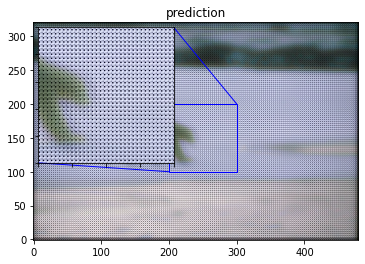

Epoch 2/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 22.50 dB
(107, 160, 1)
(1, 107, 160, 1)


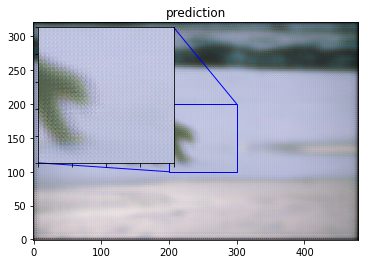

Epoch 3/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 23.83 dB
(107, 160, 1)
(1, 107, 160, 1)


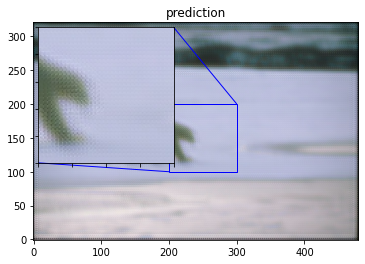

Epoch 4/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 25.05 dB
(107, 160, 1)
(1, 107, 160, 1)


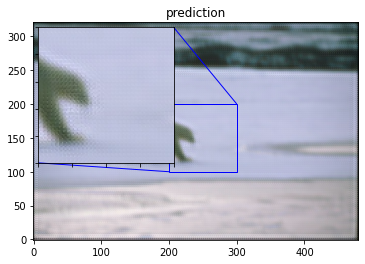

Epoch 5/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 26.13 dB
(107, 160, 1)
(1, 107, 160, 1)


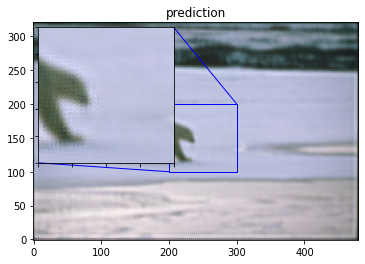

Epoch 6/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 27.34 dB
(107, 160, 1)
(1, 107, 160, 1)


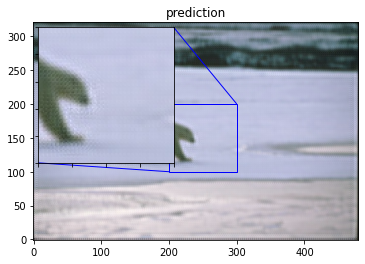

Epoch 7/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 28.30 dB
(107, 160, 1)
(1, 107, 160, 1)


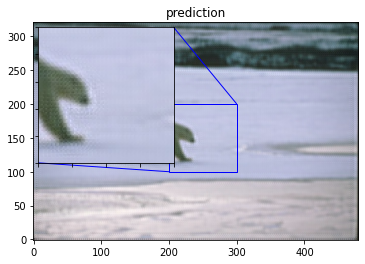

Epoch 8/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 28.98 dB
(107, 160, 1)
(1, 107, 160, 1)


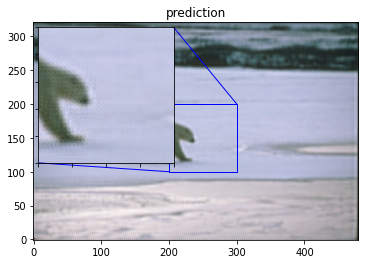

Epoch 9/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.39 dB
(107, 160, 1)
(1, 107, 160, 1)


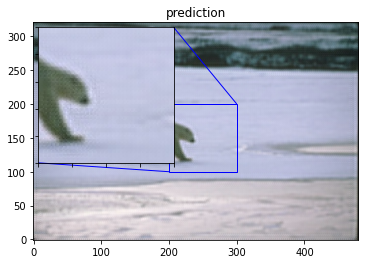

Epoch 10/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.46 dB
(107, 160, 1)
(1, 107, 160, 1)


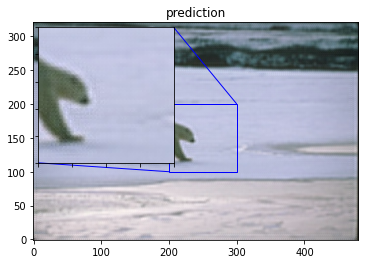

Epoch 11/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.71 dB
(107, 160, 1)
(1, 107, 160, 1)


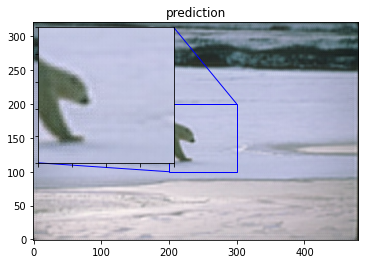

Epoch 12/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.87 dB
(107, 160, 1)
(1, 107, 160, 1)


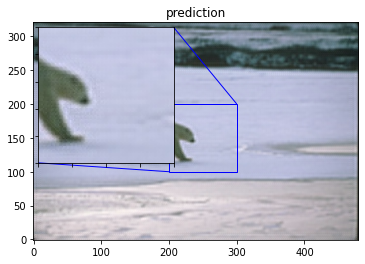

Epoch 13/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.79 dB
(107, 160, 1)
(1, 107, 160, 1)


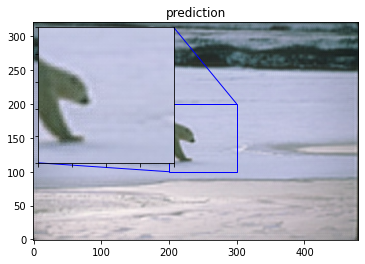

Epoch 14/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.94 dB
(107, 160, 1)
(1, 107, 160, 1)


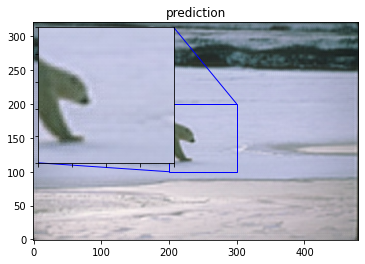

Epoch 15/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 29.97 dB
(107, 160, 1)
(1, 107, 160, 1)


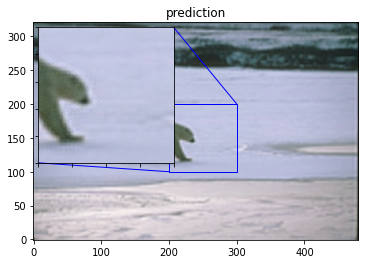

Epoch 16/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.02 dB
(107, 160, 1)
(1, 107, 160, 1)


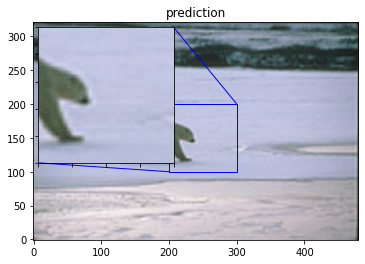

Epoch 17/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.09 dB
(107, 160, 1)
(1, 107, 160, 1)


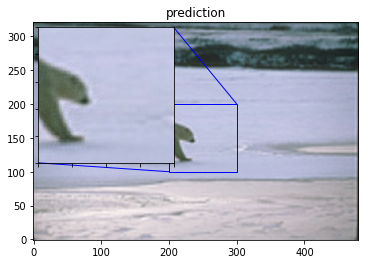

Epoch 18/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.17 dB
(107, 160, 1)
(1, 107, 160, 1)


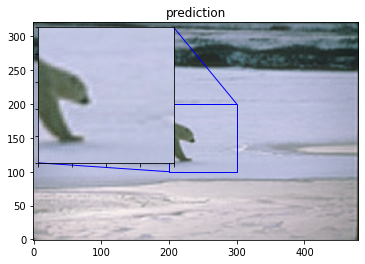

Epoch 19/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.23 dB
(107, 160, 1)
(1, 107, 160, 1)


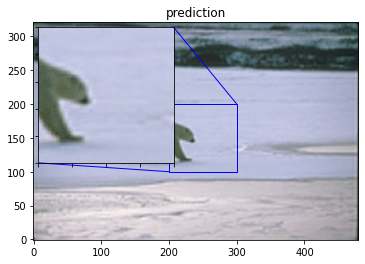

Epoch 20/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.16 dB
(107, 160, 1)
(1, 107, 160, 1)


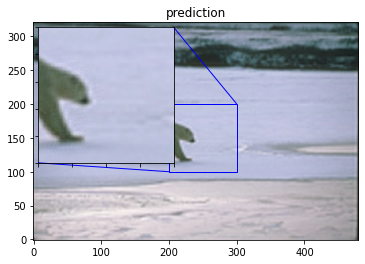

Epoch 21/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.27 dB
(107, 160, 1)
(1, 107, 160, 1)


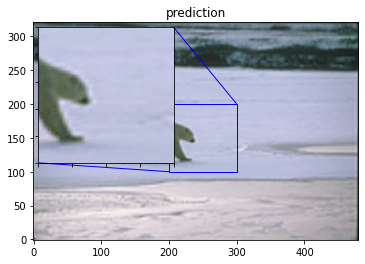

Epoch 22/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.24 dB
(107, 160, 1)
(1, 107, 160, 1)


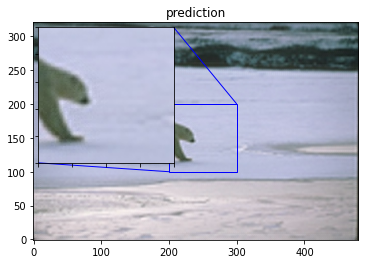

Epoch 23/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.28 dB
(107, 160, 1)
(1, 107, 160, 1)


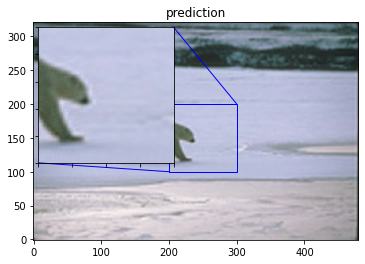

Epoch 24/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.29 dB
(107, 160, 1)
(1, 107, 160, 1)


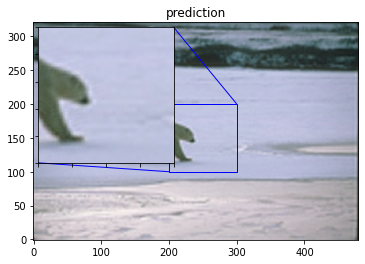

Epoch 25/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.36 dB
(107, 160, 1)
(1, 107, 160, 1)


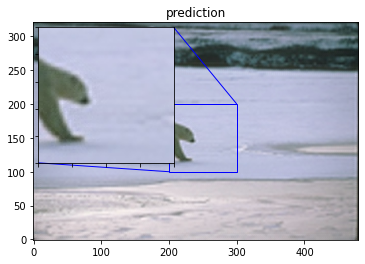

Epoch 26/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.36 dB
(107, 160, 1)
(1, 107, 160, 1)


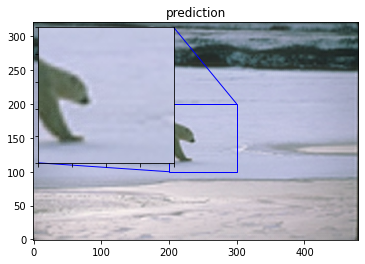

Epoch 27/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.37 dB
(107, 160, 1)
(1, 107, 160, 1)


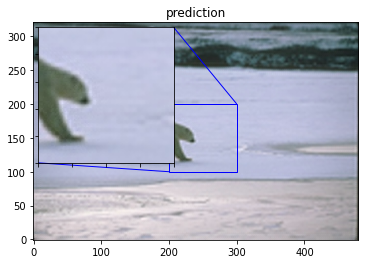

Epoch 28/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.41 dB
(107, 160, 1)
(1, 107, 160, 1)


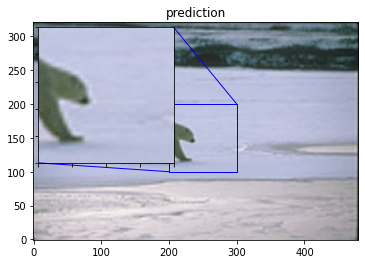

Epoch 29/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.41 dB
(107, 160, 1)
(1, 107, 160, 1)


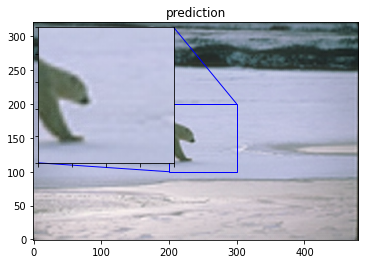

Epoch 30/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.32 dB
(107, 160, 1)
(1, 107, 160, 1)


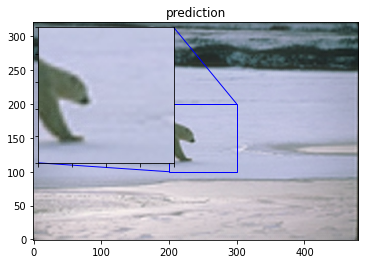

Epoch 31/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.41 dB
(107, 160, 1)
(1, 107, 160, 1)


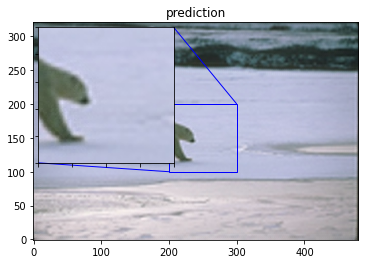

Epoch 32/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.40 dB
(107, 160, 1)
(1, 107, 160, 1)


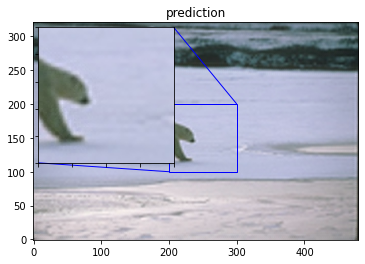

Epoch 33/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.44 dB
(107, 160, 1)
(1, 107, 160, 1)


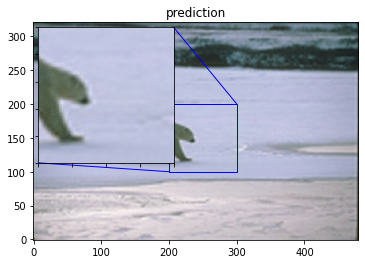

Epoch 34/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.51 dB
(107, 160, 1)
(1, 107, 160, 1)


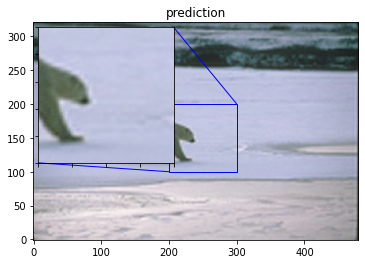

Epoch 35/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.47 dB
(107, 160, 1)
(1, 107, 160, 1)


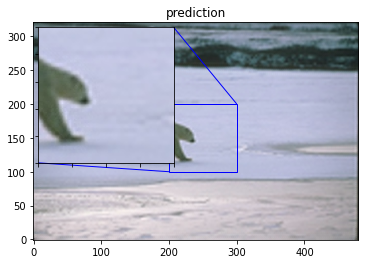

Epoch 36/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.48 dB
(107, 160, 1)
(1, 107, 160, 1)


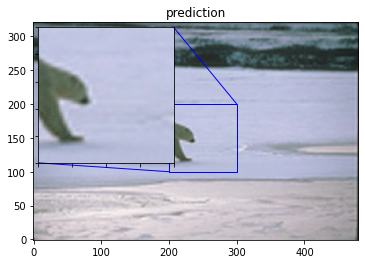

Epoch 37/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.50 dB
(107, 160, 1)
(1, 107, 160, 1)


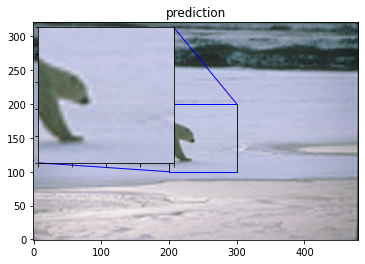

Epoch 38/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.55 dB
(107, 160, 1)
(1, 107, 160, 1)


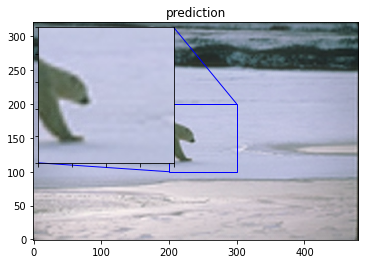

Epoch 39/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.50 dB
(107, 160, 1)
(1, 107, 160, 1)


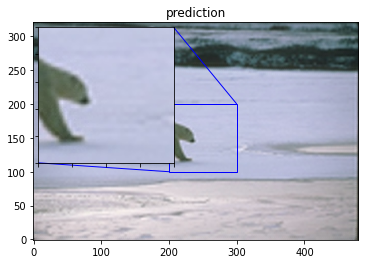

Epoch 40/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.48 dB
(107, 160, 1)
(1, 107, 160, 1)


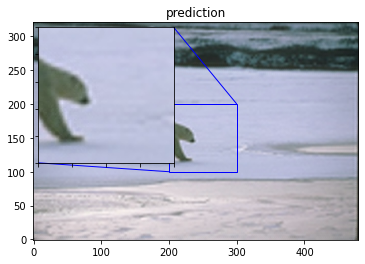

Epoch 41/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.52 dB
(107, 160, 1)
(1, 107, 160, 1)


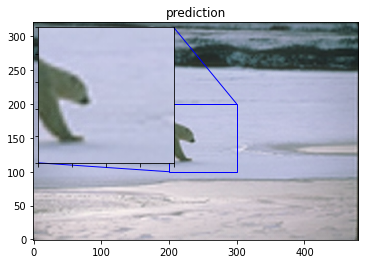

Epoch 42/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.49 dB
(107, 160, 1)
(1, 107, 160, 1)


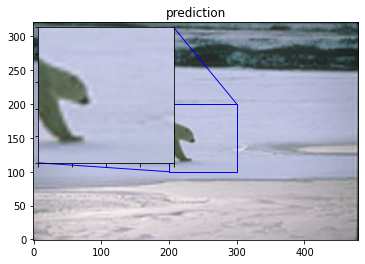

Epoch 43/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.60 dB
(107, 160, 1)
(1, 107, 160, 1)


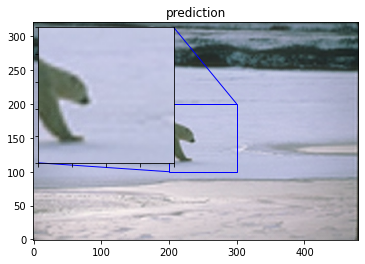

Epoch 44/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.51 dB
(107, 160, 1)
(1, 107, 160, 1)


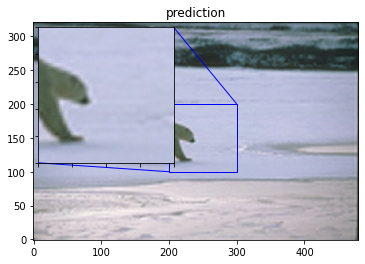

Epoch 45/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.56 dB
(107, 160, 1)
(1, 107, 160, 1)


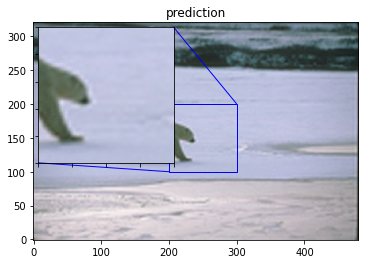

Epoch 46/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.51 dB
(107, 160, 1)
(1, 107, 160, 1)


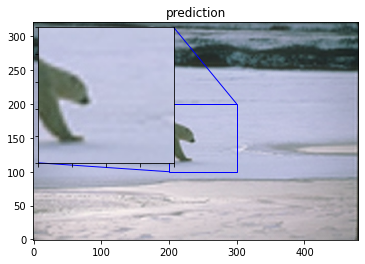

Epoch 47/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.60 dB
(107, 160, 1)
(1, 107, 160, 1)


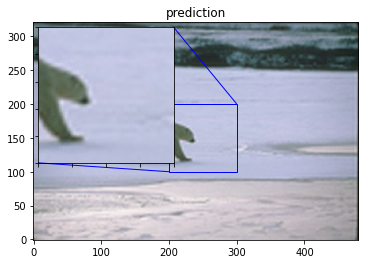

Epoch 48/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.53 dB
(107, 160, 1)
(1, 107, 160, 1)


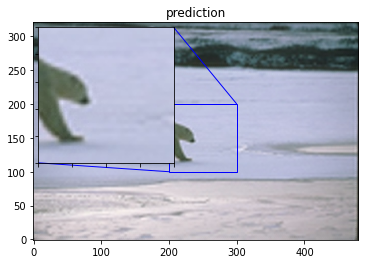

Epoch 49/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.61 dB
(107, 160, 1)
(1, 107, 160, 1)


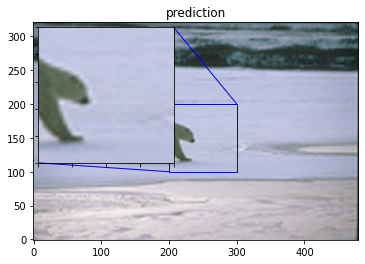

Epoch 50/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.55 dB
(107, 160, 1)
(1, 107, 160, 1)


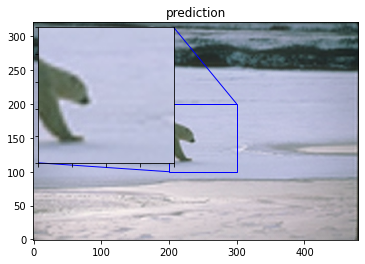

Epoch 51/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.63 dB
(107, 160, 1)
(1, 107, 160, 1)


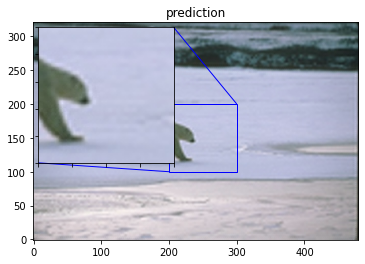

Epoch 52/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.65 dB
(107, 160, 1)
(1, 107, 160, 1)


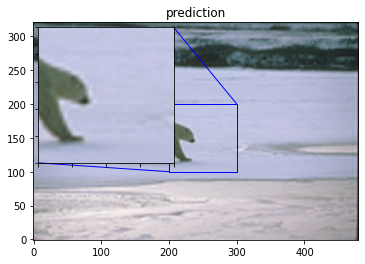

Epoch 53/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.51 dB
(107, 160, 1)
(1, 107, 160, 1)


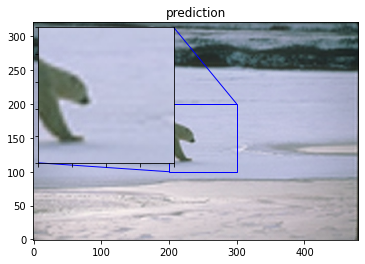

Epoch 54/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


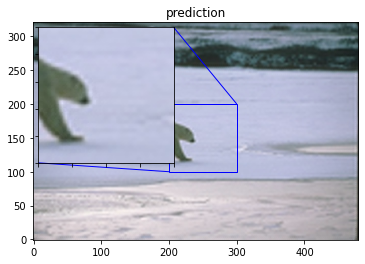

Epoch 55/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.67 dB
(107, 160, 1)
(1, 107, 160, 1)


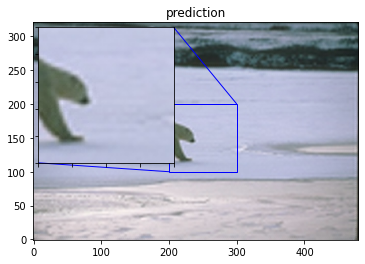

Epoch 56/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


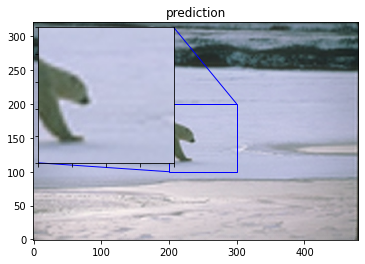

Epoch 57/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.70 dB
(107, 160, 1)
(1, 107, 160, 1)


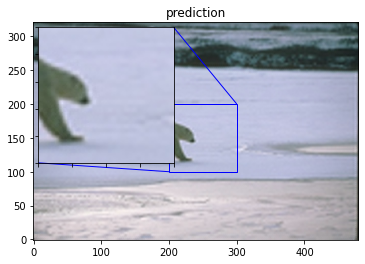

Epoch 58/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


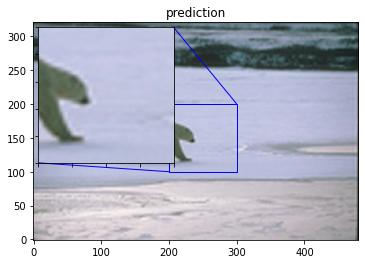

Epoch 59/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


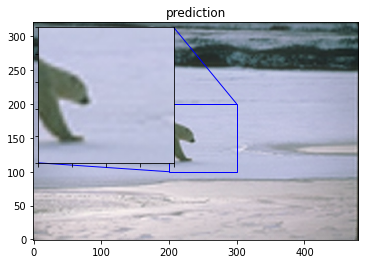

Epoch 60/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


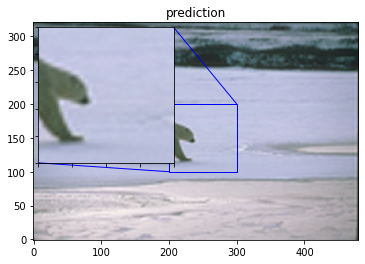

Epoch 61/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.58 dB
(107, 160, 1)
(1, 107, 160, 1)


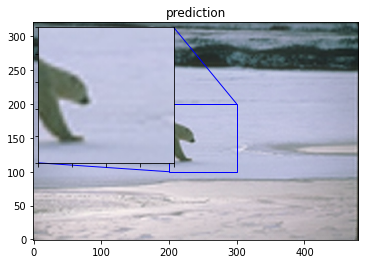

Epoch 62/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.57 dB
(107, 160, 1)
(1, 107, 160, 1)


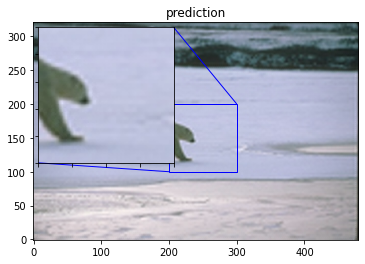

Epoch 63/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.65 dB
(107, 160, 1)
(1, 107, 160, 1)


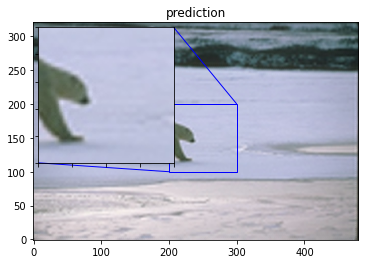

Epoch 64/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.65 dB
(107, 160, 1)
(1, 107, 160, 1)


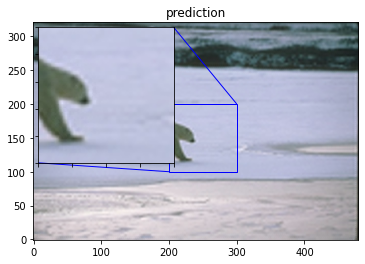

Epoch 65/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.63 dB
(107, 160, 1)
(1, 107, 160, 1)


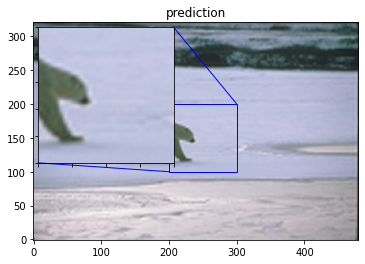

Epoch 66/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.62 dB
(107, 160, 1)
(1, 107, 160, 1)


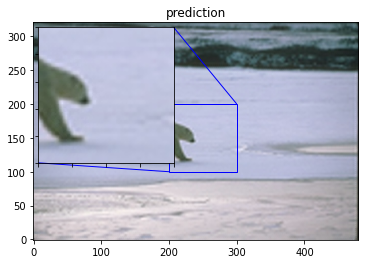

Epoch 67/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.68 dB
(107, 160, 1)
(1, 107, 160, 1)


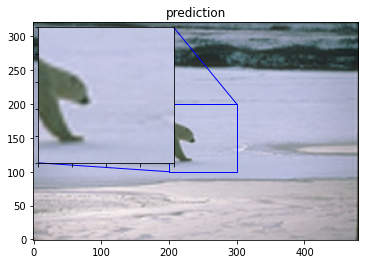

Epoch 68/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.54 dB
(107, 160, 1)
(1, 107, 160, 1)


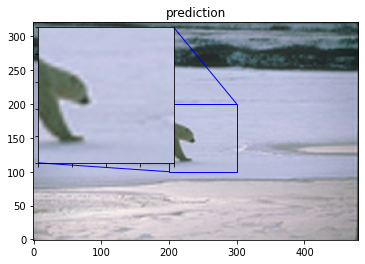

Epoch 69/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.65 dB
(107, 160, 1)
(1, 107, 160, 1)


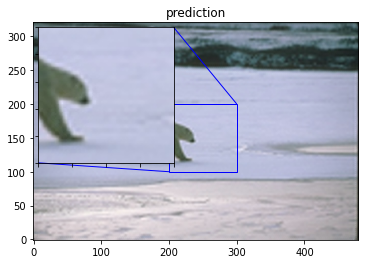

Epoch 70/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


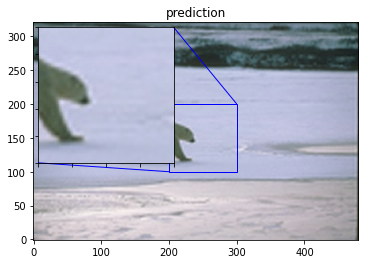

Epoch 71/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.65 dB
(107, 160, 1)
(1, 107, 160, 1)


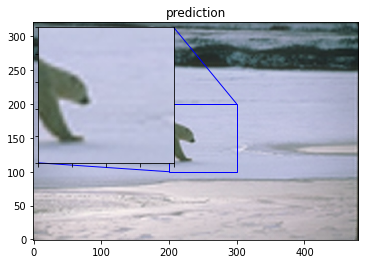

Epoch 72/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.68 dB
(107, 160, 1)
(1, 107, 160, 1)


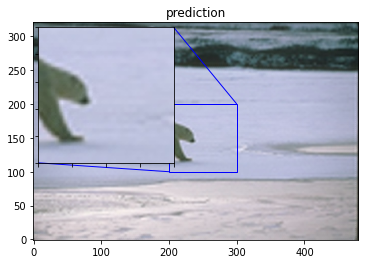

Epoch 73/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


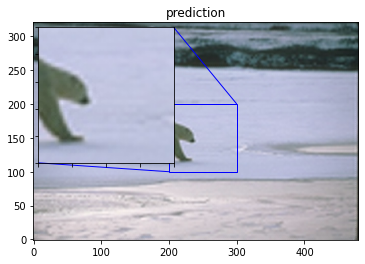

Epoch 74/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


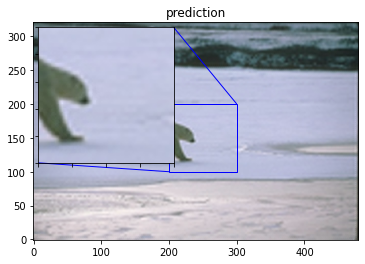

Epoch 75/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.50 dB
(107, 160, 1)
(1, 107, 160, 1)


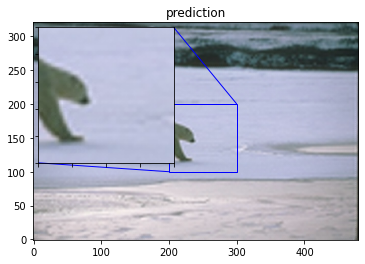

Epoch 76/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.73 dB
(107, 160, 1)
(1, 107, 160, 1)


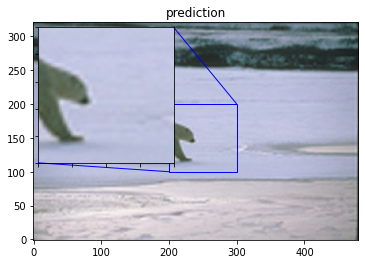

Epoch 77/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


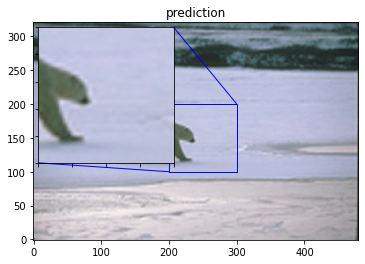

Epoch 78/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


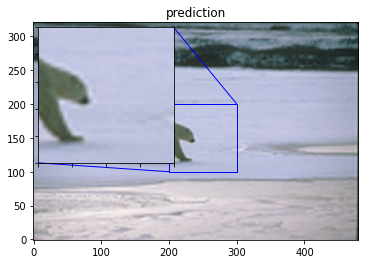

Epoch 79/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


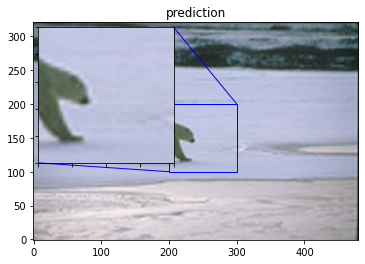

Epoch 80/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


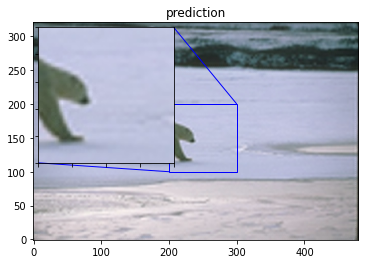

Epoch 81/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


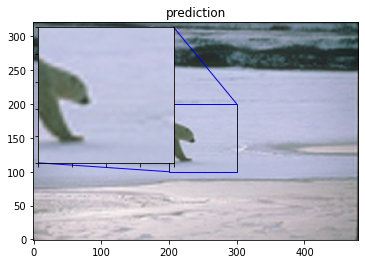

Epoch 82/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.64 dB
(107, 160, 1)
(1, 107, 160, 1)


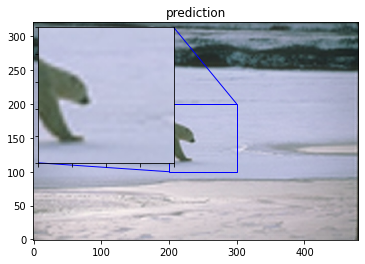

Epoch 83/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


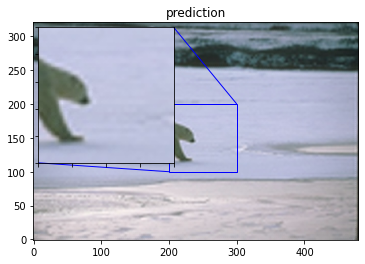

Epoch 84/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.78 dB
(107, 160, 1)
(1, 107, 160, 1)


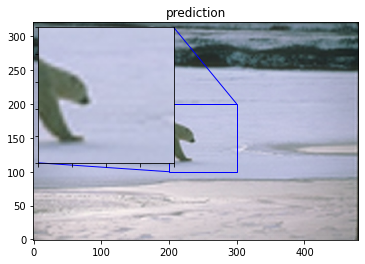

Epoch 85/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.81 dB
(107, 160, 1)
(1, 107, 160, 1)


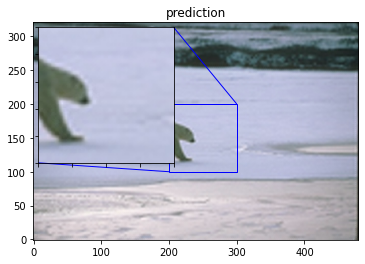

Epoch 86/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.72 dB
(107, 160, 1)
(1, 107, 160, 1)


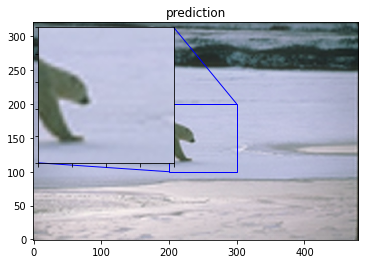

Epoch 87/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.66 dB
(107, 160, 1)
(1, 107, 160, 1)


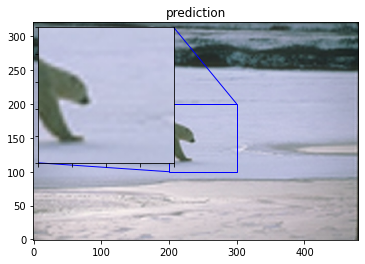

Epoch 88/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.77 dB
(107, 160, 1)
(1, 107, 160, 1)


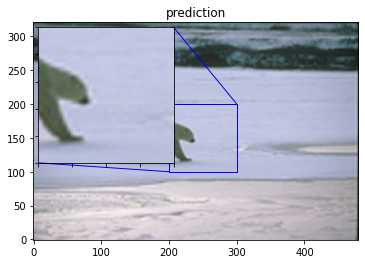

Epoch 89/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.69 dB
(107, 160, 1)
(1, 107, 160, 1)


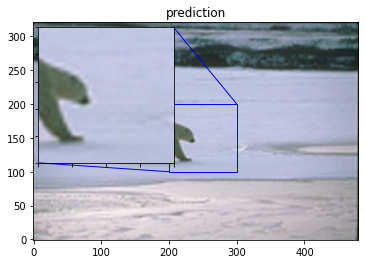

Epoch 90/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.77 dB
(107, 160, 1)
(1, 107, 160, 1)


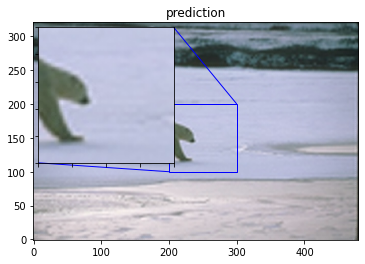

Epoch 91/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.65 dB
(107, 160, 1)
(1, 107, 160, 1)


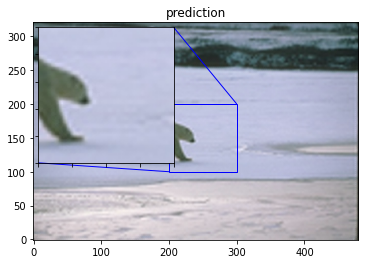

Epoch 92/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.80 dB
(107, 160, 1)
(1, 107, 160, 1)


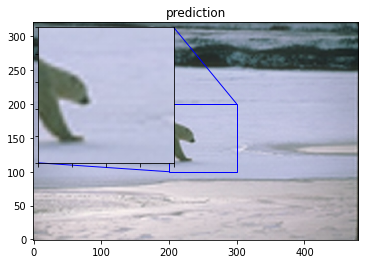

Epoch 93/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.79 dB
(107, 160, 1)
(1, 107, 160, 1)


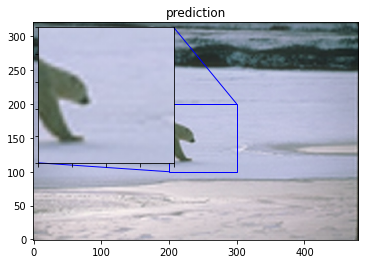

Epoch 94/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.71 dB
(107, 160, 1)
(1, 107, 160, 1)


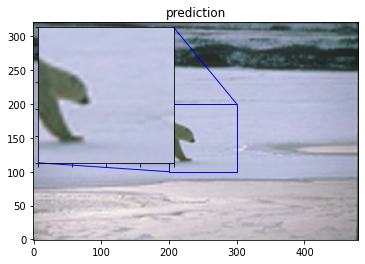

Epoch 95/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.83 dB
(107, 160, 1)
(1, 107, 160, 1)


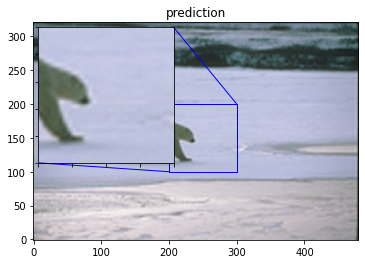

Epoch 96/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.71 dB
(107, 160, 1)
(1, 107, 160, 1)


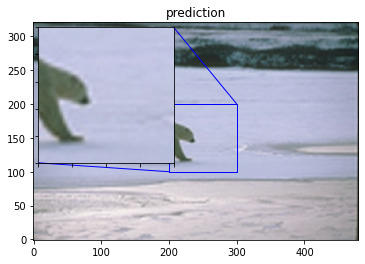

Epoch 97/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.68 dB
(107, 160, 1)
(1, 107, 160, 1)


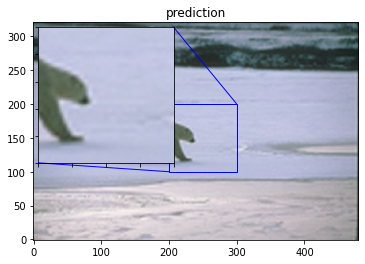

Epoch 98/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.77 dB
(107, 160, 1)
(1, 107, 160, 1)


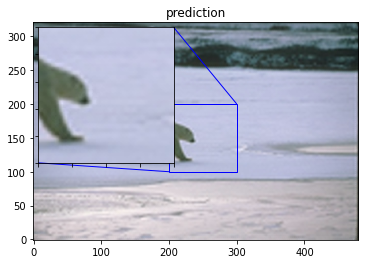

Epoch 99/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.79 dB
(107, 160, 1)
(1, 107, 160, 1)


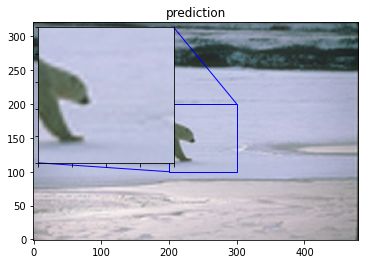

Epoch 100/100
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
(107, 160, 1)
(1, 107, 160, 1)
Mean PSNR for epoch: 30.78 dB
(107, 160, 1)
(1, 107, 160, 1)


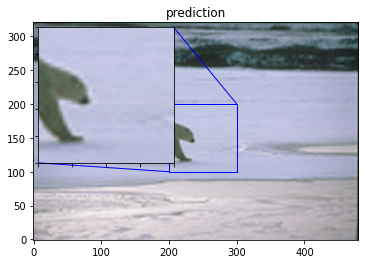

In [ ]:
epochs = 100

model.compile(
    optimizer=optimizer, loss=loss_fn,
)

model.fit(
    train_ds, epochs=epochs, callbacks=callbacks, validation_data=valid_ds, verbose=3
)

# The model weights (that are considered the best) are loaded into the model.
model.load_weights(checkpoint_filepath)
model.save('default_models.h5')

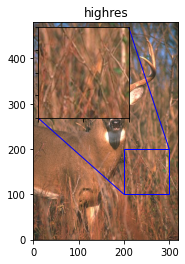

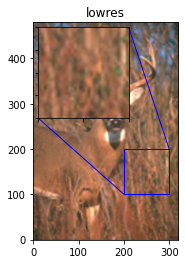

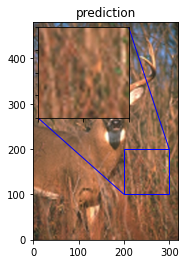

PSNR of low resolution image and high resolution image is 27.8790
PSNR of predict and high resolution is 28.2267


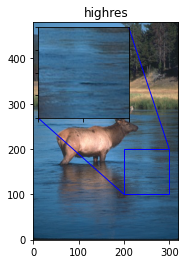

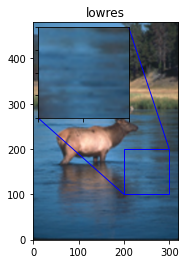

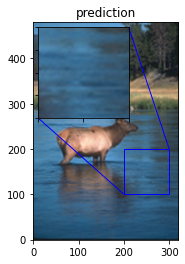

PSNR of low resolution image and high resolution image is 31.7775
PSNR of predict and high resolution is 31.8747


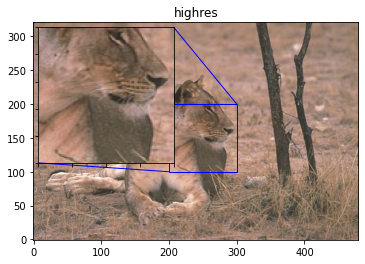

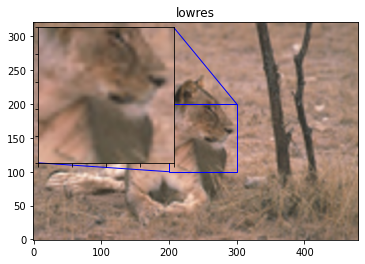

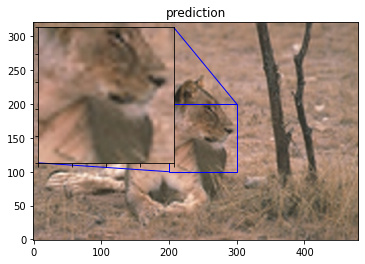

PSNR of low resolution image and high resolution image is 28.5374
PSNR of predict and high resolution is 28.8160


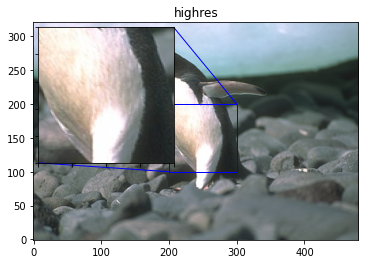

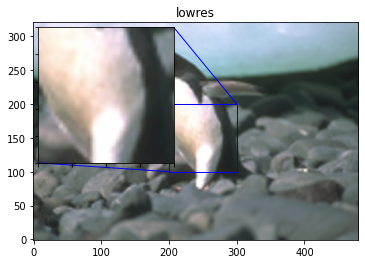

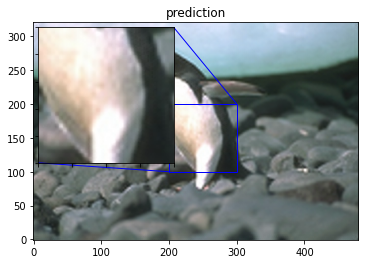

PSNR of low resolution image and high resolution image is 32.8385
PSNR of predict and high resolution is 33.0087


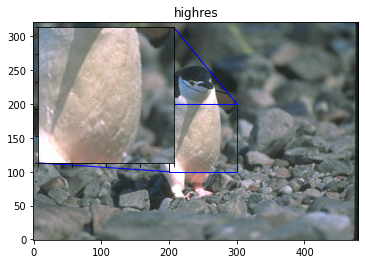

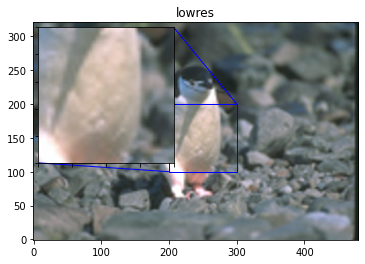

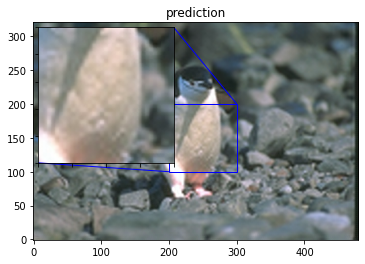

PSNR of low resolution image and high resolution image is 31.7475
PSNR of predict and high resolution is 32.1230


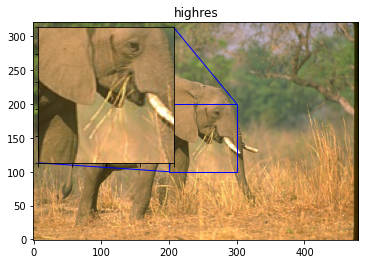

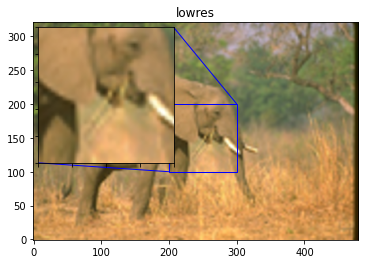

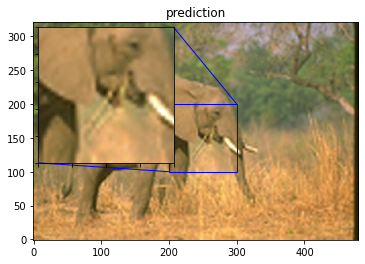

PSNR of low resolution image and high resolution image is 28.7284
PSNR of predict and high resolution is 28.9590


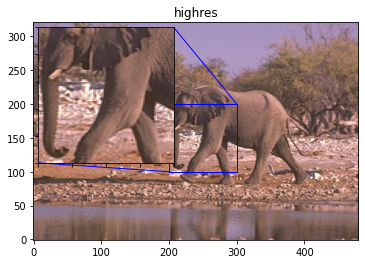

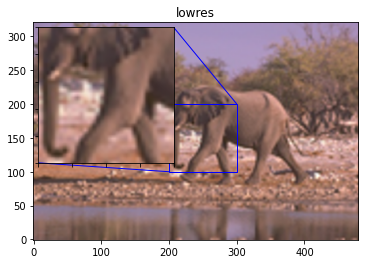

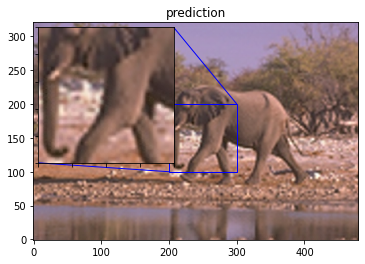

PSNR of low resolution image and high resolution image is 24.6930
PSNR of predict and high resolution is 25.0518


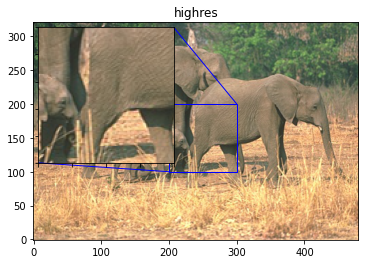

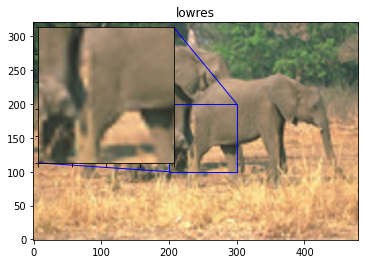

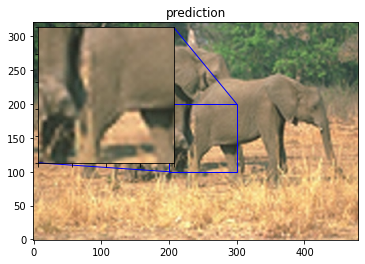

PSNR of low resolution image and high resolution image is 25.7698
PSNR of predict and high resolution is 26.0528


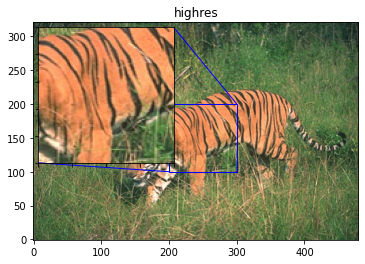

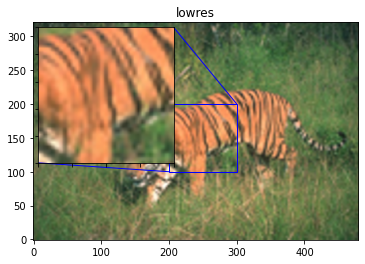

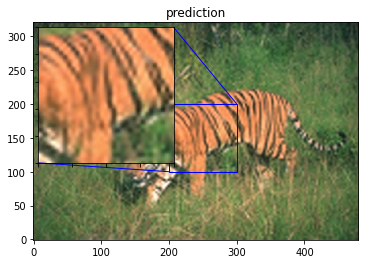

PSNR of low resolution image and high resolution image is 23.1990
PSNR of predict and high resolution is 23.5032


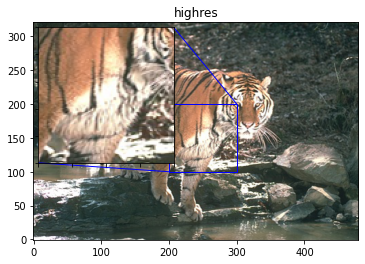

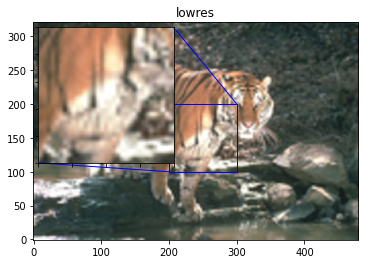

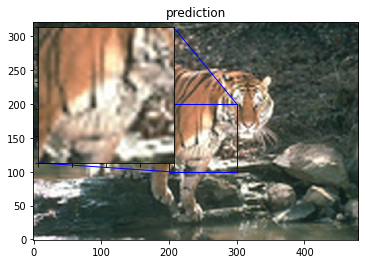

PSNR of low resolution image and high resolution image is 22.9710
PSNR of predict and high resolution is 23.4024


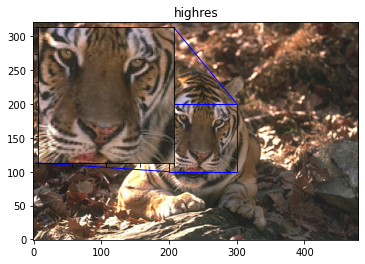

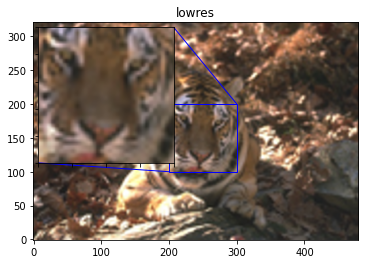

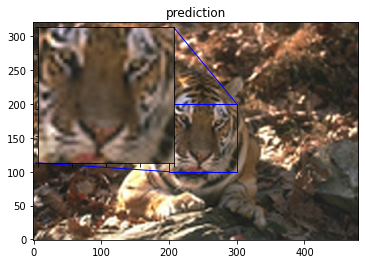

PSNR of low resolution image and high resolution image is 24.4263
PSNR of predict and high resolution is 25.1041


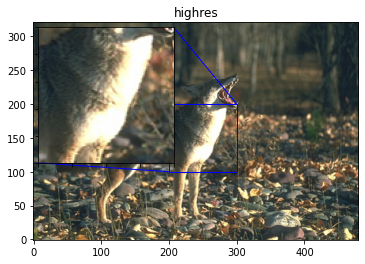

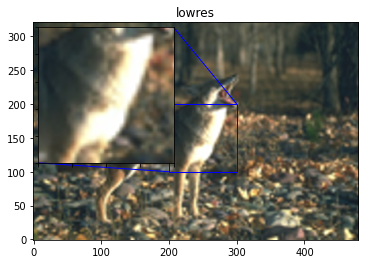

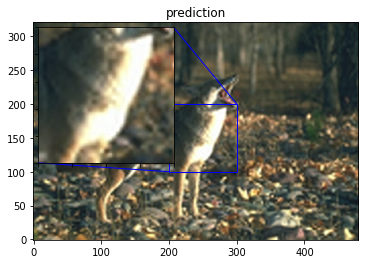

PSNR of low resolution image and high resolution image is 25.0398
PSNR of predict and high resolution is 25.4820


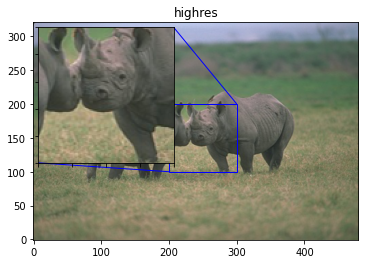

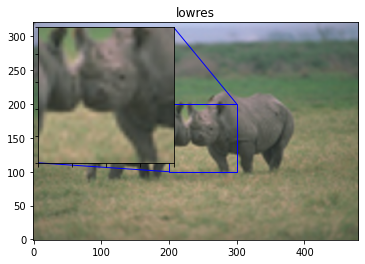

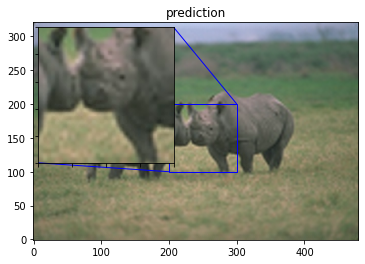

PSNR of low resolution image and high resolution image is 34.9506
PSNR of predict and high resolution is 34.7056


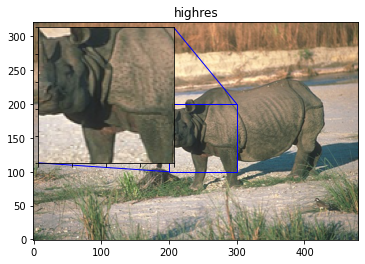

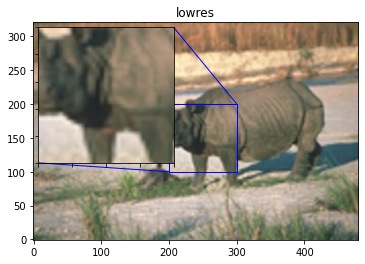

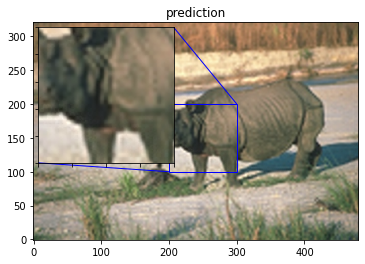

PSNR of low resolution image and high resolution image is 26.6250
PSNR of predict and high resolution is 26.9475


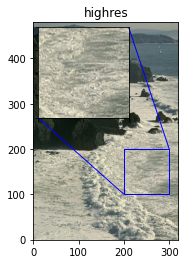

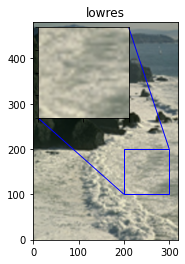

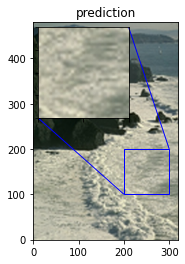

PSNR of low resolution image and high resolution image is 25.1637
PSNR of predict and high resolution is 25.4907


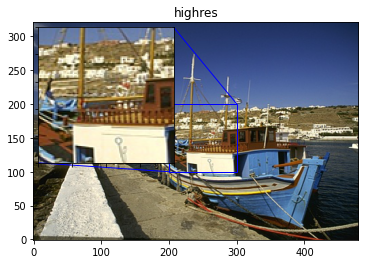

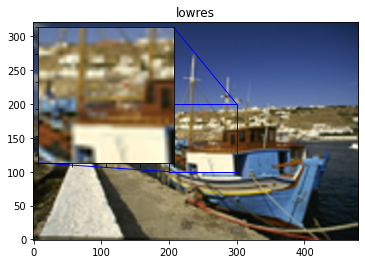

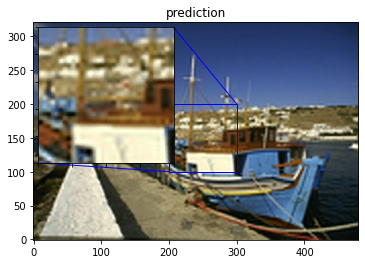

PSNR of low resolution image and high resolution image is 22.6681
PSNR of predict and high resolution is 23.0175


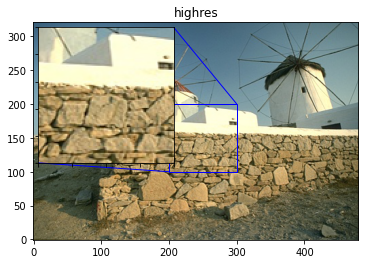

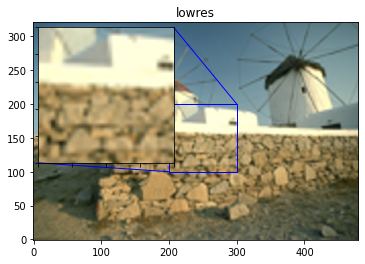

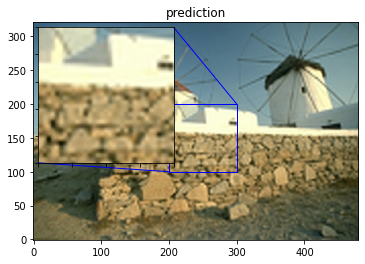

PSNR of low resolution image and high resolution image is 23.9902
PSNR of predict and high resolution is 24.3137


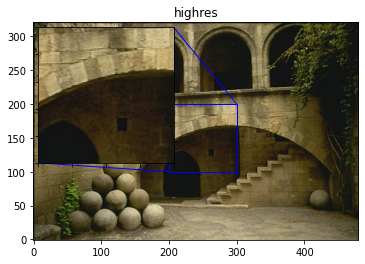

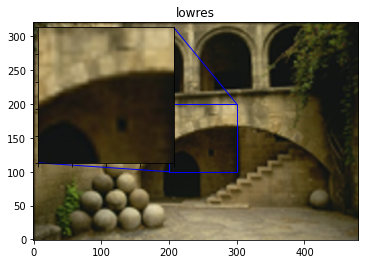

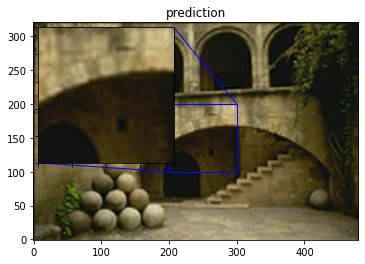

PSNR of low resolution image and high resolution image is 26.3472
PSNR of predict and high resolution is 26.7014


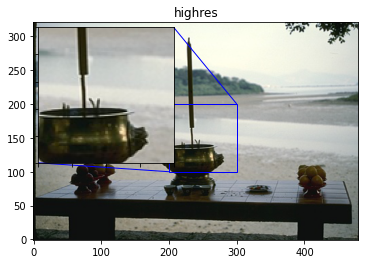

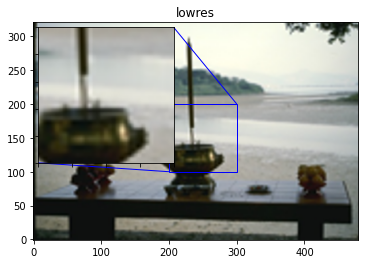

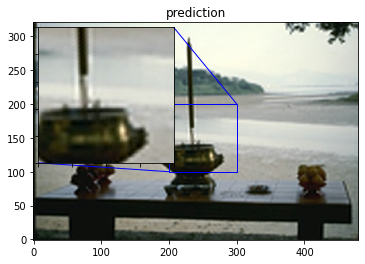

PSNR of low resolution image and high resolution image is 27.6660
PSNR of predict and high resolution is 28.1771


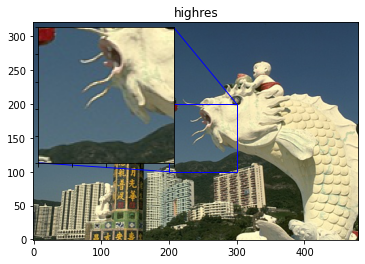

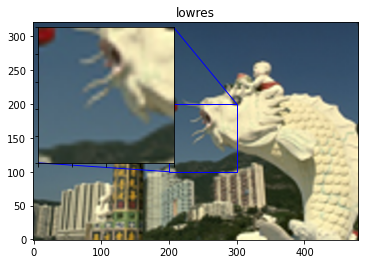

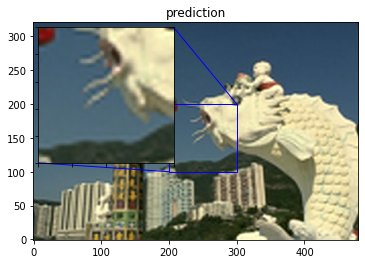

PSNR of low resolution image and high resolution image is 21.8129
PSNR of predict and high resolution is 22.0847
Avg. PSNR of lowres images is 26.8415 dB
Avg. PSNR of reconstructions is 27.1521 dB


In [ ]:
from keras.models import load_model

model = load_model('default_models.h5')

total_bicubic_psnr = 0.0
total_test_psnr = 0.0

for index, test_img_path in enumerate(test_img_paths[10:30]):
    img = load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    lowres_img = lowres_input.resize((w, h))
    prediction = upscale_image(model, lowres_input)
    lowres_img_arr = img_to_array(lowres_img)
    highres_img_arr = img_to_array(highres_img)
    predict_img_arr = img_to_array(prediction)
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    plot_results(highres_img, index, "highres")
    plot_results(lowres_img, index, "lowres")
    plot_results(prediction, index, "prediction")
    print("PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr)
    print("PSNR of predict and high resolution is %.4f" % test_psnr)

print("Avg. PSNR of lowres images is %.4f dB" % (total_bicubic_psnr / 20))
print("Avg. PSNR of reconstructions is %.4f dB" % (total_test_psnr / 20))

# modified ESPCN

In [ ]:
def get_model(upscale_factor=5, channels=5):
    conv_args = {
        "activation": "relu",
        "kernel_initializer": "Orthogonal",
        "padding": "same",
    }
    inputs = keras.Input(shape=(None, None, channels))
    x = layers.Conv2D(64, 5, **conv_args)(inputs)
    x = layers.Conv2D(128, 3, **conv_args)(x)
    x = layers.Conv2D(256, 3, **conv_args)(x)
    x = layers.Conv2D(128, 3, **conv_args)(x)
    x = layers.Conv2D(64, 3, **conv_args)(x)
    x = layers.Conv2D(channels * (upscale_factor ** 2), 3, **conv_args)(x)
    outputs = tf.nn.depth_to_space(x, upscale_factor)

    return keras.Model(inputs, outputs)

In [ ]:
class ESPCNCallback(keras.callbacks.Callback):
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.test_img = get_lowres_image(load_img(test_img_paths[0]), upscale_factor)

    # Store PSNR value in each epoch.
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):
        print("Mean PSNR for epoch: %.2f dB" % (np.mean(self.psnr)))
        prediction = upscale_image(self.model, self.test_img)
        plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        self.psnr.append(10 * math.log10(1 / logs["loss"]))

In [ ]:
class ESPCNCallback(keras.callbacks.Callback):
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.img = load_img(test_img_paths[0])
        self.test_img = get_lowres_image(self.img, upscale_factor)
        w = self.test_img.size[0] * upscale_factor
        h = self.test_img.size[1] * upscale_factor
        self.highres_img = self.img.resize((w, h))

    # Store PSNR value in each epoch.
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):
        print("Mean PSNR for epoch: %.2f dB" % (np.mean(self.psnr)))
        prediction = upscale_image(self.model, self.test_img)
        plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        self.psnr.append(tf.image.psnr(img_to_array(upscale_image(self.model, self.test_img)), img_to_array(self.highres_img), max_val=255))
        #self.psnr.append(10 * math.log10(1 / logs["loss"]))

In [ ]:
early_stopping_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=10)

checkpoint_filepath = "/tmp/checkpoint"

model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor="loss",
    mode="min",
    save_best_only=True,
)

model = get_model(upscale_factor=upscale_factor, channels=1)
model.summary()

callbacks = [ESPCNCallback(), early_stopping_callback, model_checkpoint_callback]
loss_fn = keras.losses.MeanSquaredError(reduction="auto")
optimizer = keras.optimizers.Adam(learning_rate=0.0001)

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 1)]   0         
                                                                 
 conv2d (Conv2D)             (None, None, None, 64)    1664      
                                                                 
 conv2d_1 (Conv2D)           (None, None, None, 128)   73856     
                                                                 
 conv2d_2 (Conv2D)           (None, None, None, 256)   295168    
                                                                 
 conv2d_3 (Conv2D)           (None, None, None, 128)   295040    
                                                                 
 conv2d_4 (Conv2D)           (None, None, None, 64)    73792     
                                                                 
 conv2d_5 (Conv2D)           (None, None, None, 9)     5193  

Epoch 1/100
Mean PSNR for epoch: 12.41 dB


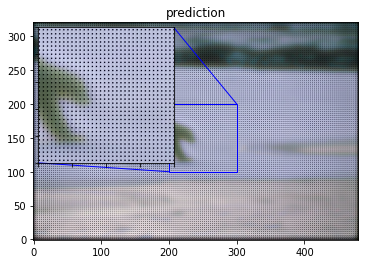

Epoch 2/100


In [ ]:
epochs = 100

model.compile(
    optimizer=optimizer, loss=loss_fn,
)

model.fit(
    train_ds, epochs=epochs, callbacks=callbacks, validation_data=valid_ds, verbose=3
)

# The model weights (that are considered the best) are loaded into the model.
model.load_weights(checkpoint_filepath)
model.save('modified_models.h5')

In [ ]:
from keras.models import load_model

model = load_model('modified_models.h5')

total_bicubic_psnr = 0.0
total_test_psnr = 0.0

for index, test_img_path in enumerate(test_img_paths[10:30]):
    img = load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    lowres_img = lowres_input.resize((w, h))
    prediction = upscale_image(model, lowres_input)
    lowres_img_arr = img_to_array(lowres_img)
    highres_img_arr = img_to_array(highres_img)
    predict_img_arr = img_to_array(prediction)
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    plot_results(highres_img, index, "highres")
    plot_results(lowres_img, index, "lowres")
    plot_results(prediction, index, "prediction")
    print("PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr)
    print("PSNR of predict and high resolution is %.4f" % test_psnr)

print("Avg. PSNR of lowres images is %.4f dB" % (total_bicubic_psnr / 20))
print("Avg. PSNR of reconstructions is %.4f dB" % (total_test_psnr / 20))